# Summary

Welcome to the Binary Classification with Bank Churn Dataset competition! In this challenge, our goal is to predict customer churn based on a comprehensive set of information. The dataset comprises 13 columns, each offering valuable insights into customer behavior and characteristics:

    01. Customer ID: A unique identifier for each customer.
    02. Surname: The customer's last name or surname.
    03. Credit Score: A numerical representation of the customer's credit score.
    04. Geography: The country where the customer resides, with options including France, Spain, or Germany.
    05. Gender: The customer's gender, categorized as Male or Female.
    06. Age: The customer's age.
    07. Tenure: The number of years the customer has been associated with the bank.  
    08. Balance: The current account balance of the customer.
    09. NumOfProducts: The count of bank products the customer uses, such as savings accounts or credit cards.
    10. HasCrCard: A binary indicator of whether the customer possesses a credit card (1 = yes, 0 = no).
    11. IsActiveMember: A binary indicator of the customer's active membership status (1 = yes, 0 = no).
    12. EstimatedSalary: The estimated salary of the customer.
    13. Exited: The target variable indicating whether the customer has churned (1 = yes, 0 = no).
    
Throughout the competition, our performance will be evaluated using the Area Under the ROC Curve (AUC-ROC) metric, a widely-used measure for assessing binary classification models. For more details about the original dataset, please refer to the Kaggle dataset page: [Bank Customer Churn Prediction](https://www.kaggle.com/datasets/shantanudhakadd/bank-customer-churn-prediction). Let's embark on this predictive analytics journey and strive for accurate churn predictions!

# Imports

In [55]:
# Libraries for data wrangling
import pandas as pd
import numpy as np 
# Libraries for data visualization
import matplotlib.pyplot as plt
import seaborn as sns
#Library to see the progress
from tqdm import tqdm


# Libraries with functions used in modelling
from sklearn.base import clone
from sklearn.inspection import permutation_importance
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import squareform
from category_encoders import MEstimateEncoder
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_auc_score, roc_curve, make_scorer, mean_squared_error, accuracy_score
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler, MaxAbsScaler

# Libraries with the models
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.ensemble import HistGradientBoostingClassifier, GradientBoostingClassifier, VotingClassifier
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
import optuna

# Library to ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [56]:
import sys
sys.path.insert(0, r'C:\Users\Vitor\Documents\Repositórios\Kaggle\utils')
# Custom functions to analyze data
from eda_functions import summary_statistics, heatmap, feature_distance
from model_functions import adversarial_validation, cross_val_score


In [57]:
sns.set_theme(style = 'white', palette = 'viridis')
pal = sns.color_palette('viridis')

In [58]:
seed = 10

# Loading data

In [59]:
df_train = pd.read_csv("data/train.csv", index_col='id')
df_test = pd.read_csv("data/test.csv", index_col='id')

In [60]:
numerical_features = list(df_test._get_numeric_data())
categorical_features = list(df_test.drop(numerical_features, axis = 1))

# Encoding of the data

In [61]:
# 'categorical_columns' should contain the names of the categorical columns you want to encode
onehot_columns = ['Geography', 'Gender']  # replace with your actual column names

# Extract the categorical columns from the DataFrame
df_onehot = df_train[onehot_columns]

# Create an instance of OneHotEncoder
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)

# Fit and transform the categorical columns
df_train_encoded = pd.DataFrame(encoder.fit_transform(df_onehot), columns=encoder.get_feature_names_out(onehot_columns))

# Concatenate the one-hot encoded columns with the original DataFrame
df_train = pd.concat([df_train, df_train_encoded], axis=1)

# Drop the original categorical columns if needed
df_train = df_train.drop(onehot_columns, axis=1)




In [62]:
mencoder = MEstimateEncoder(cols=['Surname'])

In [63]:
df_train_mencoded = mencoder.fit_transform(df_train.drop(columns=['Exited']), df_train.Exited)

In [64]:
# 'categorical_columns' should contain the names of the categorical columns you want to encode
onehot_columns = ['Geography', 'Gender']  # replace with your actual column names

# Extract the categorical columns from the DataFrame
df_onehot_test = df_test[onehot_columns]

# Create an instance of OneHotEncoder
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)

# Fit and transform the categorical columns
df_test_encoded = pd.DataFrame(encoder.fit_transform(df_onehot_test), columns=encoder.get_feature_names_out(onehot_columns))

# Drop the original categorical columns if needed
df_test = pd.merge(left=df_test.reset_index().reset_index(), right=df_test_encoded.reset_index(), how='inner', on='index').drop(columns=['index'] + onehot_columns)

In [65]:
df_test = df_test.set_index('id')

# LGBM optimization

## Data processing

In [66]:
data = df_train_mencoded
target = df_train.Exited

In [67]:
def objective(trial,data=data,target=target, seed=seed):
    
    train_x, test_x, train_y, test_y = train_test_split(data, target, test_size=0.2,random_state=seed)
    param = {
        'random_state': seed,
        'n_estimators': 20000,
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-3, 10.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-3, 10.0),
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02]),
        'max_depth': trial.suggest_categorical('max_depth', [10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 1, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300)
    }
    model = LGBMClassifier(**param)  
    
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)])
    
    preds = model.predict(test_x)
    
    accuracy = accuracy_score(test_y, preds)
    
    return accuracy

In [68]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=20)
print(f'Number of finished trials:: {len(study.trials)}')
print(f'Best trial: {study.best_trial.params}')

[I 2024-01-11 13:00:43,091] A new study created in memory with name: no-name-b4fef7d0-eb30-43a7-bad6-5a98bd11c00e


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001591 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:06:58,422] Trial 0 finished with value: 0.8616354106704638 and parameters: {'reg_alpha': 0.23579202358899415, 'reg_lambda': 0.0011536128449388555, 'colsample_bytree': 0.8, 'subsample': 0.4, 'learning_rate': 0.006, 'max_depth': 100, 'num_leaves': 956, 'min_child_samples': 100}. Best is trial 0 with value: 0.8616354106704638.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002455 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:08:28,721] Trial 1 finished with value: 0.8664525706668282 and parameters: {'reg_alpha': 0.32667276926531086, 'reg_lambda': 0.001531980076749805, 'colsample_bytree': 0.5, 'subsample': 0.7, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 753, 'min_child_samples': 271}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:11:04,230] Trial 2 finished with value: 0.8609991819916988 and parameters: {'reg_alpha': 1.955020909699771, 'reg_lambda': 8.679234789639054, 'colsample_bytree': 0.4, 'subsample': 0.8, 'learning_rate': 0.017, 'max_depth': 20, 'num_leaves': 757, 'min_child_samples': 65}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000375 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:14:00,410] Trial 3 finished with value: 0.8595146484079135 and parameters: {'reg_alpha': 0.2771702170599654, 'reg_lambda': 0.631716756610831, 'colsample_bytree': 0.4, 'subsample': 0.4, 'learning_rate': 0.01, 'max_depth': 20, 'num_leaves': 719, 'min_child_samples': 247}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:17:26,235] Trial 4 finished with value: 0.8606053261429394 and parameters: {'reg_alpha': 0.004965740126646364, 'reg_lambda': 0.009507561270168325, 'colsample_bytree': 0.3, 'subsample': 0.7, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 510, 'min_child_samples': 33}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:23:34,907] Trial 5 finished with value: 0.8593631653891599 and parameters: {'reg_alpha': 0.005292002395203201, 'reg_lambda': 0.7817043848588592, 'colsample_bytree': 0.3, 'subsample': 1.0, 'learning_rate': 0.008, 'max_depth': 100, 'num_leaves': 900, 'min_child_samples': 83}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002699 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:24:32,851] Trial 6 finished with value: 0.8655436725543066 and parameters: {'reg_alpha': 7.518129110038127, 'reg_lambda': 0.012130469434923121, 'colsample_bytree': 0.6, 'subsample': 0.4, 'learning_rate': 0.017, 'max_depth': 100, 'num_leaves': 521, 'min_child_samples': 3}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:27:20,469] Trial 7 finished with value: 0.8592116823704062 and parameters: {'reg_alpha': 0.008502026080038444, 'reg_lambda': 9.556708724228079, 'colsample_bytree': 0.4, 'subsample': 0.7, 'learning_rate': 0.014, 'max_depth': 20, 'num_leaves': 579, 'min_child_samples': 232}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353


[I 2024-01-11 13:31:38,293] Trial 8 finished with value: 0.862483715575484 and parameters: {'reg_alpha': 0.0021586387525026236, 'reg_lambda': 0.19858292707176514, 'colsample_bytree': 0.9, 'subsample': 1.0, 'learning_rate': 0.01, 'max_depth': 100, 'num_leaves': 526, 'min_child_samples': 49}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002466 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:33:50,266] Trial 9 finished with value: 0.8601205804829278 and parameters: {'reg_alpha': 0.4387461972740971, 'reg_lambda': 3.3724052575773196, 'colsample_bytree': 0.5, 'subsample': 0.5, 'learning_rate': 0.017, 'max_depth': 10, 'num_leaves': 295, 'min_child_samples': 73}. Best is trial 1 with value: 0.8664525706668282.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003032 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:34:33,820] Trial 10 finished with value: 0.8703305359469203 and parameters: {'reg_alpha': 0.03379946205881631, 'reg_lambda': 0.015407132159538867, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 16, 'min_child_samples': 300}. Best is trial 10 with value: 0.8703305359469203.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002653 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353


[I 2024-01-11 13:35:05,719] Trial 11 finished with value: 0.8715121034931984 and parameters: {'reg_alpha': 0.03600649471294888, 'reg_lambda': 0.001098625821420411, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 6, 'min_child_samples': 288}. Best is trial 11 with value: 0.8715121034931984.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002952 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353


[I 2024-01-11 13:35:38,702] Trial 12 finished with value: 0.8702093495319174 and parameters: {'reg_alpha': 0.04055647207889279, 'reg_lambda': 0.01018778888392361, 'colsample_bytree': 0.5, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 9, 'min_child_samples': 185}. Best is trial 11 with value: 0.8715121034931984.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353


[I 2024-01-11 13:36:17,085] Trial 13 finished with value: 0.871663586511952 and parameters: {'reg_alpha': 0.030057745217174227, 'reg_lambda': 0.04027909133999637, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 9, 'min_child_samples': 292}. Best is trial 13 with value: 0.871663586511952.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002778 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:37:59,090] Trial 14 finished with value: 0.8636046899142606 and parameters: {'reg_alpha': 0.03175898014384221, 'reg_lambda': 0.059401594604619294, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 230, 'min_child_samples': 186}. Best is trial 13 with value: 0.871663586511952.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001492 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:39:26,451] Trial 15 finished with value: 0.8629987578392462 and parameters: {'reg_alpha': 0.06328684831618958, 'reg_lambda': 0.0032113630865191387, 'colsample_bytree': 1.0, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 190, 'min_child_samples': 300}. Best is trial 13 with value: 0.871663586511952.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:41:08,788] Trial 16 finished with value: 0.859241978974157 and parameters: {'reg_alpha': 0.01030065163798995, 'reg_lambda': 0.05634106840952098, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 144, 'min_child_samples': 209}. Best is trial 13 with value: 0.871663586511952.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003155 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:42:58,880] Trial 17 finished with value: 0.865180113309298 and parameters: {'reg_alpha': 0.0010121107546153729, 'reg_lambda': 0.16459481494562, 'colsample_bytree': 0.7, 'subsample': 0.5, 'learning_rate': 0.006, 'max_depth': 10, 'num_leaves': 359, 'min_child_samples': 128}. Best is trial 13 with value: 0.871663586511952.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-01-11 13:44:25,347] Trial 18 finished with value: 0.8639076559517678 and parameters: {'reg_alpha': 0.1217079694751632, 'reg_lambda': 0.004304689536771628, 'colsample_bytree': 0.9, 'subsample': 0.8, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 131, 'min_child_samples': 265}. Best is trial 13 with value: 0.871663586511952.


[LightGBM] [Info] Number of positive: 27804, number of negative: 104223
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003005 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.210593 -> initscore=-1.321353
[LightGBM] [Info] Start training from score -1.321353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[I 2024-01-11 13:46:06,498] Trial 19 finished with value: 0.8646650710455358 and parameters: {'reg_alpha': 0.01828855838649374, 'reg_lambda': 0.028368262059186904, 'colsample_bytree': 0.6, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 339, 'min_child_samples': 154}. Best is trial 13 with value: 0.871663586511952.


Number of finished trials:: 20
Best trial: {'reg_alpha': 0.030057745217174227, 'reg_lambda': 0.04027909133999637, 'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.008, 'max_depth': 10, 'num_leaves': 9, 'min_child_samples': 292}


In [69]:
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_colsample_bytree,params_learning_rate,params_max_depth,params_min_child_samples,params_num_leaves,params_reg_alpha,params_reg_lambda,params_subsample,state
0,0,0.861635,2024-01-11 13:00:43.092282,2024-01-11 13:06:58.421727,0 days 00:06:15.329445,0.8,0.006,100,100,956,0.235792,0.001154,0.4,COMPLETE
1,1,0.866453,2024-01-11 13:06:58.422727,2024-01-11 13:08:28.720829,0 days 00:01:30.298102,0.5,0.008,10,271,753,0.326673,0.001532,0.7,COMPLETE
2,2,0.860999,2024-01-11 13:08:28.721829,2024-01-11 13:11:04.229608,0 days 00:02:35.507779,0.4,0.017,20,65,757,1.955021,8.679235,0.8,COMPLETE
3,3,0.859515,2024-01-11 13:11:04.230609,2024-01-11 13:14:00.410155,0 days 00:02:56.179546,0.4,0.010,20,247,719,0.277170,0.631717,0.4,COMPLETE
4,4,0.860605,2024-01-11 13:14:00.411156,2024-01-11 13:17:26.235611,0 days 00:03:25.824455,0.3,0.014,20,33,510,0.004966,0.009508,0.7,COMPLETE
5,5,0.859363,2024-01-11 13:17:26.236612,2024-01-11 13:23:34.907910,0 days 00:06:08.671298,0.3,0.008,100,83,900,0.005292,0.781704,1.0,COMPLETE
6,6,0.865544,2024-01-11 13:23:34.908909,2024-01-11 13:24:32.851133,0 days 00:00:57.942224,0.6,0.017,100,3,521,7.518129,0.012130,0.4,COMPLETE
7,7,0.859212,2024-01-11 13:24:32.852133,2024-01-11 13:27:20.469266,0 days 00:02:47.617133,0.4,0.014,20,232,579,0.008502,9.556709,0.7,COMPLETE
8,8,0.862484,2024-01-11 13:27:20.470267,2024-01-11 13:31:38.293250,0 days 00:04:17.822983,0.9,0.010,100,49,526,0.002159,0.198583,1.0,COMPLETE
9,9,0.860121,2024-01-11 13:31:38.294250,2024-01-11 13:33:50.265309,0 days 00:02:11.971059,0.5,0.017,10,73,295,0.438746,3.372405,0.5,COMPLETE


In [73]:
optuna.visualization.plot_optimization_history(study)

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'mode': 'markers',
              'name': 'Objective Value',
              'type': 'scatter',
              'x': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,
                    18, 19],
              'y': [0.8616354106704638, 0.8664525706668282, 0.8609991819916988,
                    0.8595146484079135, 0.8606053261429394, 0.8593631653891599,
                    0.8655436725543066, 0.8592116823704062, 0.862483715575484,
                    0.8601205804829278, 0.8703305359469203, 0.8715121034931984,
                    0.8702093495319174, 0.871663586511952, 0.8636046899142606,
                    0.8629987578392462, 0.859241978974157, 0.865180113309298,
                    0.8639076559517678, 0.8646650710455358]},
             {'mode': 'lines',
              'name': 'Best Value',
              'type': 'scatter',
              'x': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,
                    18, 19],
              'y': [0.8616354106704638, 0.8664525706668282, 0.8664525706668282,
                    0.8664525706668282, 0.8664525706668282, 0.8664525706668282,
                    0.8664525706668282, 0.8664525706668282, 0.8664525706668282,
                    0.8664525706668282, 0.8703305359469203, 0.8715121034931984,
                    0.8715121034931984, 0.871663586511952, 0.871663586511952,
                    0.871663586511952, 0.871663586511952, 0.871663586511952,
                    0.871663586511952, 0.871663586511952]},
             {'marker': {'color': '#cccccc'},
              'mode': 'markers',
              'name': 'Infeasible Trial',
              'showlegend': False,
              'type': 'scatter',
              'x': [],
              'y': []}],
    'layout': {'template': '...',
               'title': {'text': 'Optimization History Plot'},
               'xaxis': {'title': {'text': 'Trial'}},
               'yaxis': {'title': {'text': 'Objective Value'}}}
})

In [74]:
splits = 5
skf = StratifiedKFold(n_splits = splits, random_state = seed, shuffle = True)
np.random.seed(seed)

In [78]:
params = study.best_params
params['random_state'] = seed
params['n_estimators'] = 20000

[LightGBM] [Info] Number of positive: 27937, number of negative: 104090
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1380
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.211601 -> initscore=-1.315304
[LightGBM] [Info] Start training from score -1.315304
[LightGBM] [Info] Number of positive: 27937, number of negative: 104090
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1381
[LightGBM] [Info] Number of data points in the train set: 132027, number of used features: 15
[LightGBM] [In

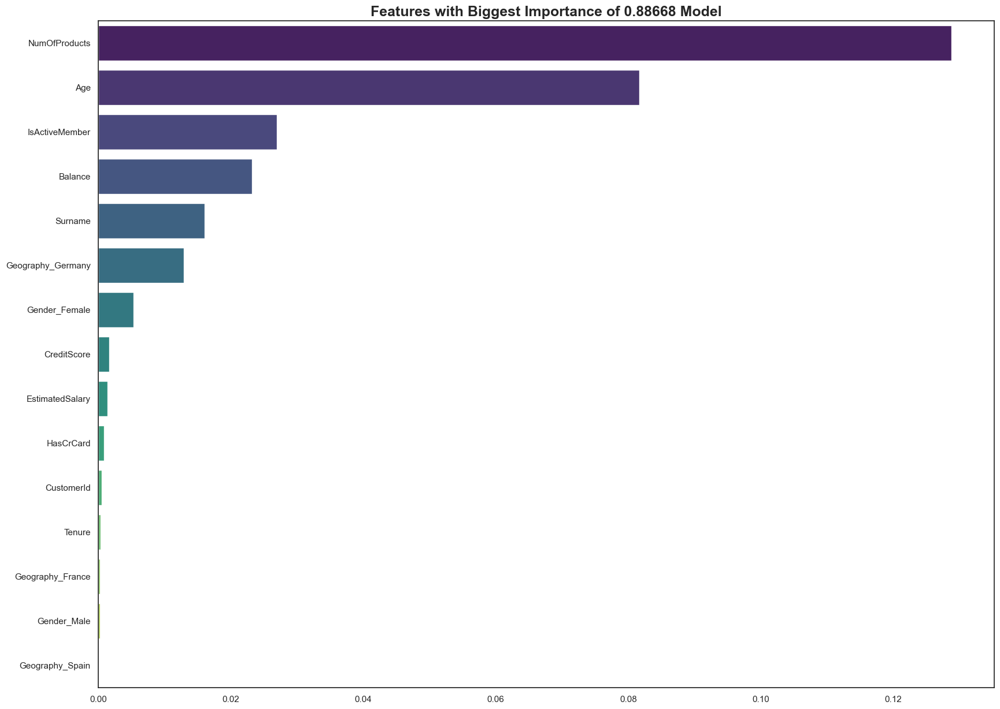

([0.8889952634199398,
  0.8864761986477817,
  0.8871925746890836,
  0.8858556333066998,
  0.8848951346613664],
 array([0.02728599, 0.02096885, 0.0198377 , ..., 0.06012894, 0.10191253,
        0.15309645]))

In [79]:
cross_val_score(dataset=df_train, 
                estimator = make_pipeline(MEstimateEncoder(cols = ['Surname']), StandardScaler(), LGBMClassifier(**params)),
                cv = skf,
                seed = seed,
                label='lgbm',
                show_importance = True)